In [154]:
# This script generates simulated data according to the 2x polynomials f_1 and f_2 in script "investigate_polynomial_
# shape"
# Data is plotted as a continuous pdf and also as a 1D landscape using KDE
# Noise is kept at a constant low of 0.01

In [366]:
# Import 3rd party packages

using DifferentialEquations, StochasticDiffEq, LinearAlgebra, Calculus, Discretizers, KernelDensity, Distributions
using JLD2, FileIO, DataFrames, LaTeXStrings;
using DelimitedFiles,CSV, Query;
using Plots;

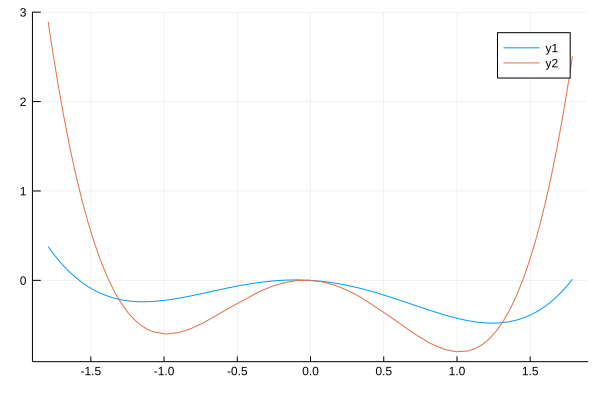

In [367]:
##################################
########### f_1 & f_2 ############
##################################
a1=0.7
b1=0.0
c1=1.0
d1=0.1
f_1(x) = (a1*x^4)/4 - (b1*x^3)/3 - (c1*x^2)/2 - d1*x

# stable stat: x=-1.14168; x=1.24240
# saddle: x=-0.100715

a3=2.8
b3=0.0
c3=2.8
d3=0.1
f_3(x) = (a3*x^4)/4 - (b3*x^3)/3 - (c3*x^2)/2 - d3*x

# stable stat: x=-0.98164; x=1.01740
# saddle: x=-0.035760

plot([f_1,f_3], -1.8, 1.8)

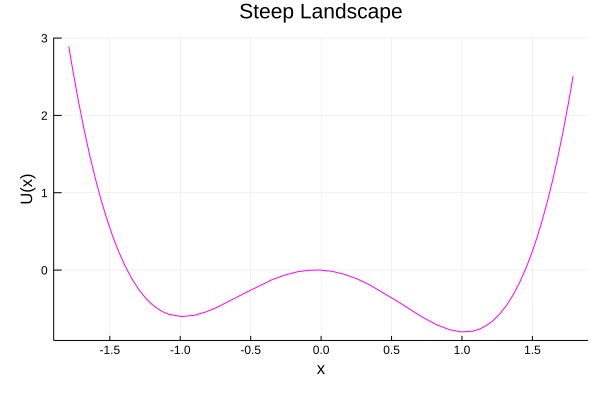

In [412]:
p1_1=plot(f_1, -1.8, 1.8,ylims=(-1,3),legend=false,xlabel="x",ylabel="U(x)",title="Shallow Landscape")
p1_2=plot(f_3, -1.8, 1.8,legend=false,color="magenta",xlabel="x",ylabel="U(x)",title="Steep Landscape")

In [369]:
##################################
########## SDE FUNCTION ##########
##################################
function sde(x₀, α, a, c)
    b=0.0
    d=0.1
    f(x,p,t) = -a*x^3+b*x^2+c*x+d
    g(x,p,t) = α*x
    tspan = (0.0,10.0) 
    prob = SDEProblem(f,g,x₀,tspan)
    saveat = 0.001
    sol = solve(prob,alg_hints=[:stiff],saveat=saveat)
    return sol
end
##################################

sde (generic function with 1 method)

In [370]:
##################################
########### SIMULATION ###########
##################################

# Define some parameters

# Define noise term here
α=0.01
# Create an array of initial conditions [start:step_size:stop]
# Is it worth having such a small step size??? - Investigate (0.1 vs. 0.01)
in_cond = collect(-2.0:0.1:2.0)
# Number of iterations per initial condition
# Is it worth having more iterations - investigate (100 vs. 1000)
iter = 100
# Values of c parameter to use when solving the SDE
params = [[a1,c1],[a3,c3]]

# Generate data according to 4 different functions (4 different values for c parameter)

# Array of solutions for each function
all_sols_f1 = Array{RODESolution,2}(undef,iter,length(in_cond))
all_sols_f2 = Array{RODESolution,2}(undef,iter,length(in_cond));

In [371]:
##################################
########### SIMULATION ###########
##################################

######################################################
# Loop over each initial starting condition
for temp_init in 1:length(in_cond)    
    # Run this code iter times for each starting condition
    for temp_iter in 1:iter
        for p in params
            sol_i = sde(in_cond[temp_init],α,p[1],p[2])
            if p == params[1]
                all_sols_f1[temp_iter, temp_init] = sol_i
            elseif p == params[2]
                all_sols_f2[temp_iter, temp_init] = sol_i
            end
        end               
    end
end
######################################################

In [372]:
"""
Generate a normalized pdf from continuous data.
"""
function genkde(data)

    filter!(x -> !isnan(x), data)    # Remove nans from data

    kdeObj = kde(data)
    x = collect(range(minimum(data),stop=maximum(data),length=10000)) # length must be dt x 
    y_1 = map(z->pdf(kdeObj,z),x)
    y = log.(y_1)

    return (x,y)

end

genkde

In [373]:
########## OBTAIN VALUES FOR KDE AND PLOTTING PER FUNCTION ##########

In [374]:
plot_step_size = 10;

# Generate continious data from all_sols for use in univariate kde per function
# data contains every 10th value for all timepoints 

data_f1 = Array{Float64, 1}()
for ii in 1:length(in_cond)
    for jj in 1:iter
        data_f1 = vcat(data_f1, all_sols_f1[jj,ii].u[1:plot_step_size:end])
    end
end

data_f2 = Array{Float64, 1}()
for ii in 1:length(in_cond)
    for jj in 1:iter
        data_f2 = vcat(data_f2, all_sols_f2[jj,ii].u[1:plot_step_size:end])
    end
end

In [263]:
########## DENSITY ESTIMATION PER FUNCTION ##########

In [377]:
x1,y1 = genkde(data_f1)
x2,y2 = genkde(data_f2);

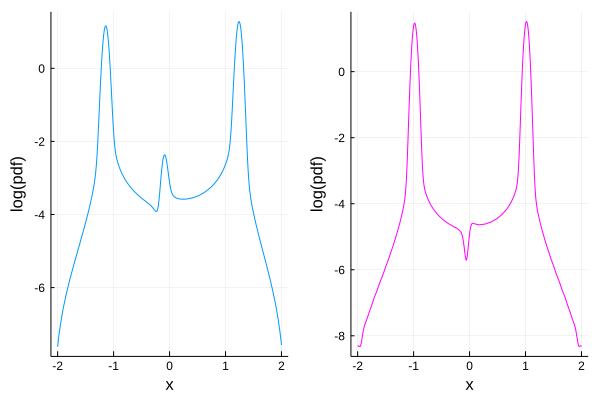

In [398]:
p2_1 = plot(x1,y1,xlabel="x",ylabel="log(pdf)",legend=false)
p2_2 = plot(x2,y2,xlabel="x",ylabel="log(pdf)",legend=false,color="magenta")
fig = plot(p2_1,p2_2,label=["f1" "f2"])

In [379]:
########## 1D LANDSCAPE PER FUNCTION ##########

In [380]:
"""
Generate a 1D landscape from continuous data.
"""
function genlandscape(data)

    filter!(x -> !isnan(x), data)    # Remove nans from data

    kdeObj = kde(data)
    x = kdeObj.x
    y = -log.(kdeObj.density.+1)

    return (x,y)

end

genlandscape

In [381]:
xland1,yland1 = genlandscape(data_f1)
xland2,yland2 = genlandscape(data_f2);

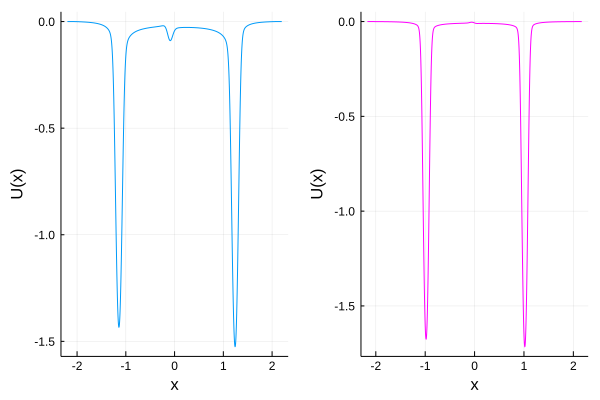

In [408]:
p3_1 = plot(xland1,yland1,xlabel="x",ylabel="U(x)",legend=false)
p3_2 = plot(xland2,yland2,xlabel="x",ylabel="U(x)",legend=false,color="magenta")
fig = plot(p3_1,p3_2,label=["f1" "f2"])

In [383]:
# Start the SDE at the saddle node and run x simulations
# See how often it terminates at stable stat point 1 and how often it terminates at stable stat point 2

# Want to record all points in order to create a plot like Rowan's
# Also want to record the last point to work out the frequency of ending in stable stat 1 or 2

In [384]:
##################################
########### SIMULATION ###########
##################################

# Define some parameters

# Define noise term here
α=0.01
# Create an array of initial conditions [start:step_size:stop]
# Is it worth having such a small step size??? - Investigate (0.1 vs. 0.01)
in_cond = [-0.100715,-0.035760]
# Number of iterations per initial condition
# Is it worth having more iterations - investigate (100 vs. 1000)
iter = 1000
# Values of c parameter to use when solving the SDE
params = [[a1,c1],[a3,c3]]

# Generate data according to 4 different functions (4 different values for c parameter)

# Array of solutions for each function
all_sols_f1_saddle = Array{RODESolution,2}(undef,iter,1)
all_sols_f2_saddle = Array{RODESolution,2}(undef,iter,1);

In [385]:
##################################
########### SIMULATION ###########
##################################

######################################################
# Run this code iter times for each starting condition
for temp_iter in 1:iter
    for p in params
        for i in in_cond
            sol_i = sde(i,α,p[1],p[2])
            if p == params[1] && i == in_cond[1]
                all_sols_f1_saddle[temp_iter, length(in_cond[1])] = sol_i
            elseif p == params[2] && i == in_cond[2]
                all_sols_f2_saddle[temp_iter, length(in_cond[2])] = sol_i
            end
        end               
    end
end

######################################################

In [386]:
# Create a timecourse plot for each function

p4_1 = plot(all_sols_f1_saddle[1],lw=1.0)
for i in 1:15
    plot!(p4_1, all_sols_f1_saddle[i],lw=1.0,legend=false,xlabel="time",ylabel="x")
end
p4_1 

In [387]:
p4_2 = plot(all_sols_f2_saddle[1],lw=1.0)
for i in 1:15
    plot!(p4_2, all_sols_f2_saddle[i],lw=1.0,legend=false,xlabel="time",ylabel="x")
end
p4_2 

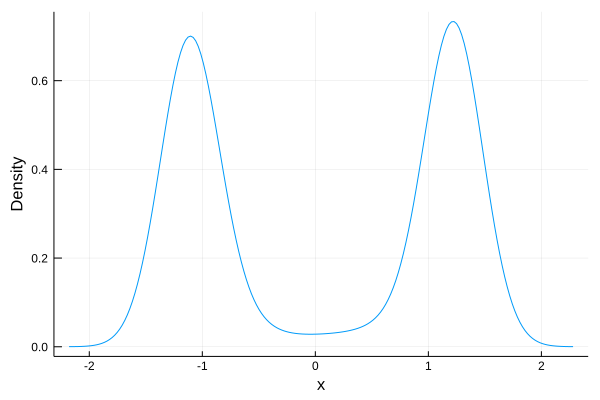

In [388]:
end_points_f1=[]

for i in 1:1000
    append!(end_points_f1,all_sols_f1_saddle[i].u[end])
end

using StatsPlots
p5_1 = density(end_points_f1,xlabel="x",ylabel="Density",legend=false)

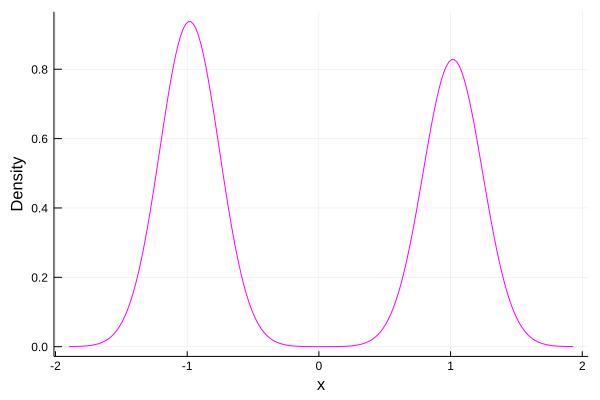

In [400]:
end_points_f2=[]

for i in 1:1000
    append!(end_points_f2,all_sols_f2_saddle[i].u[end])
end

using StatsPlots
p5_2=density(end_points_f2,xlabel="x",ylabel="Density",legend=false,color="magenta")

In [ ]:
# Start the SDE near a stable stationary point and see how often in "jumps" to the other stable stat point
# Probably never when noise is low

In [414]:
##################################
########### SIMULATION ###########
##################################

# Define some parameters

# Define noise term here
α=0.01
# Create an array of initial conditions [start:step_size:stop]
# Is it worth having such a small step size??? - Investigate (0.1 vs. 0.01)
in_cond = [-1.0,1.1]
# Number of iterations per initial condition
# Is it worth having more iterations - investigate (100 vs. 1000)
iter = 1000
# Values of c parameter to use when solving the SDE
params = [[a1,c1],[a3,c3]]

# Generate data according to 4 different functions (4 different values for c parameter)

# Array of solutions for each function
all_sols_f1_stat1 = Array{RODESolution,2}(undef,iter,1)
all_sols_f2_stat1 = Array{RODESolution,2}(undef,iter,1)
all_sols_f1_stat2 = Array{RODESolution,2}(undef,iter,1)
all_sols_f2_stat2 = Array{RODESolution,2}(undef,iter,1);

In [415]:
##################################
########### SIMULATION ###########
##################################

######################################################
# Run this code iter times for each starting condition
for temp_iter in 1:iter
    for p in params
        for i in in_cond
            sol_i = sde(i,α,p[1],p[2])
            if p == params[1] && i == in_cond[1]
                all_sols_f1_stat1[temp_iter, length(in_cond[1])] = sol_i
            elseif p == params[1] && i == in_cond[2]
                all_sols_f1_stat2[temp_iter, length(in_cond[2])] = sol_i
            elseif p == params[2] && i == in_cond[1]
                all_sols_f2_stat1[temp_iter, length(in_cond[1])] = sol_i
            elseif p == params[2] && i == in_cond[2]
                all_sols_f2_stat2[temp_iter, length(in_cond[2])] = sol_i
            end
        end               
    end
end

######################################################

In [416]:
# Create a timecourse plot for each function

p6_1 = plot(all_sols_f1_stat1[1],lw=1.0)
for i in 1:15
    plot!(p6_1, all_sols_f1_stat1[i],lw=1.0,legend=false,xlabel="time",ylabel="x")
end
p6_1 

In [417]:
p7_1 = plot(all_sols_f1_stat2[1],lw=1.0)
for i in 1:15
    plot!(p7_1, all_sols_f1_stat2[i],lw=1.0,legend=false,xlabel="time",ylabel="x")
end
p7_1 

In [418]:
p8_2 = plot(all_sols_f2_stat1[1],lw=1.0)
for i in 1:15
    plot!(p8_2, all_sols_f2_stat1[i],lw=1.0,legend=false,xlabel="time",ylabel="x")
end
p8_2 

In [419]:
p9_2 = plot(all_sols_f2_stat2[1],lw=1.0)
for i in 1:15
    plot!(p9_2, all_sols_f2_stat2[i],lw=1.0,legend=false,xlabel="time",ylabel="x")
end
p9_2 

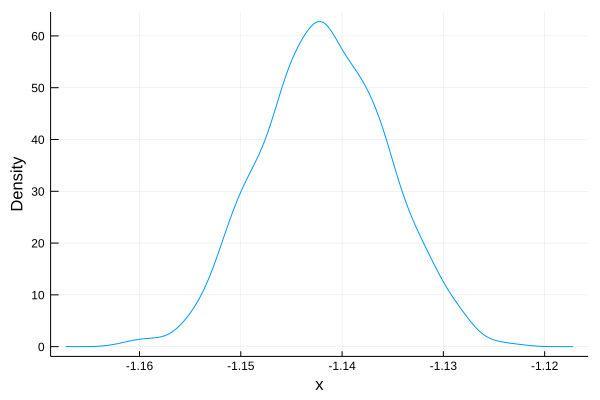

In [420]:
end_points_f1_stat1=[]

for i in 1:1000
    append!(end_points_f1_stat1,all_sols_f1_stat1[i].u[end])
end

using StatsPlots
p10_1 = density(end_points_f1_stat1,xlabel="x",ylabel="Density",legend=false)

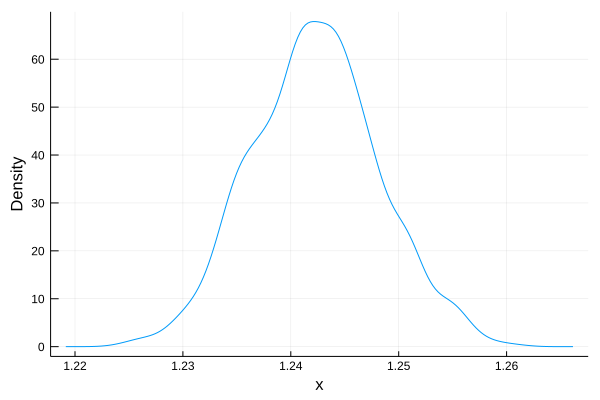

In [421]:
end_points_f1_stat2=[]

for i in 1:1000
    append!(end_points_f1_stat2,all_sols_f1_stat2[i].u[end])
end

using StatsPlots
p11_1 = density(end_points_f1_stat2,xlabel="x",ylabel="Density",legend=false)

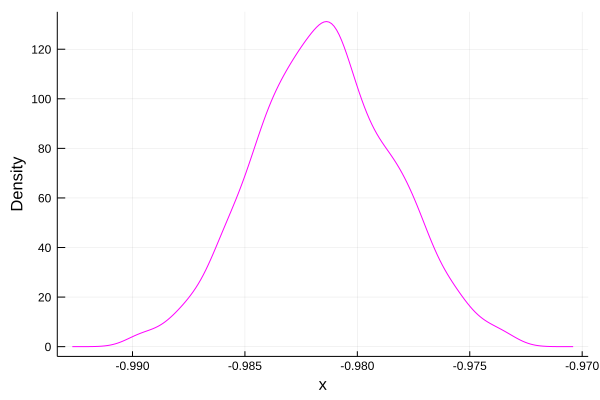

In [422]:
end_points_f2_stat1=[]

for i in 1:1000
    append!(end_points_f2_stat1,all_sols_f2_stat1[i].u[end])
end

using StatsPlots
p12_2=density(end_points_f2_stat1,xlabel="x",ylabel="Density",legend=false,color="magenta")

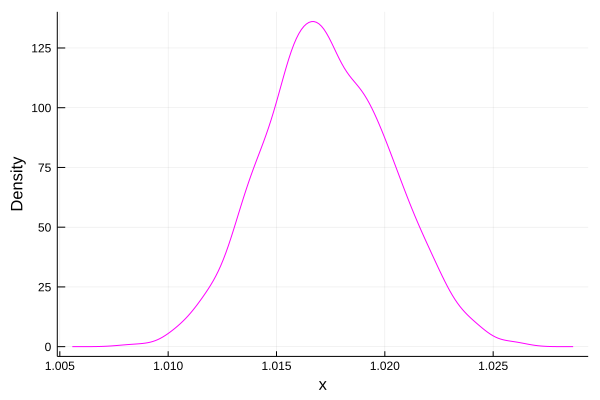

In [424]:
end_points_f2_stat2=[]

for i in 1:1000
    append!(end_points_f2_stat2,all_sols_f2_stat2[i].u[end])
end

using StatsPlots
p13_2=density(end_points_f2_stat2,xlabel="x",ylabel="Density",legend=false,color="magenta")

In [413]:
plot(p1_1,p1_2,p2_1,p2_2,p3_1,p3_2,p4_1,p4_2,p5_1,p5_2,layout=(5,2),size=(1000,1000))

In [ ]:
# Things to investigate:
# 1. Does having a smaller step size in initial condition make a difference (0.01 vs. 0.1)
# YES: having a smaller step size makes us miss the points at the saddle node!!!
# 2. Does having more iterations make a difference (100 vs. 1000)
# YES, it makes some difference in making peaks more pronounced
# 3. Does having a smaller plot step size make a difference (10 vs. 5)
# No, not really. Saw some increased stochasticity in f2
# 4. Does decreasing f1 c from 1.0 to 0.7 make a difference to the saddle node being more pronounced?
# NO, the result is worse - you end up losing the saddle node peak